In [1]:
import numpy as np
from sklearn.decomposition import PCA
from matplotlib import pyplot as plt
from matplotlib import rcParams
rcParams.update({'figure.autolayout': True})

In [2]:
%load_ext autoreload
%autoreload 2
from lib.RadialBasisFunction import RBF

In [3]:
data = np.genfromtxt("data/MI_timesteps.txt", dtype='int', skip_header=1000)

In [4]:
data.shape

(14002, 10)

In [5]:
WINDOW_LENGTH = 351
windows_data = np.stack([data[i:i+WINDOW_LENGTH, 1:4].flatten() for i in range(len(data)-WINDOW_LENGTH)])


In [6]:
windows_data.shape

(13651, 1053)

In [7]:
pca = PCA(n_components=3)
pca_data = pca.fit_transform(windows_data)

In [8]:
pca_data.shape

(13651, 3)

<Figure size 432x288 with 0 Axes>

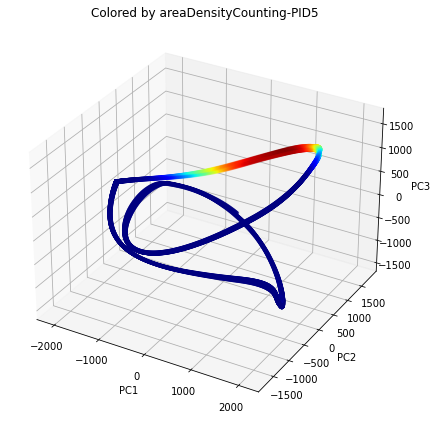

<Figure size 432x288 with 0 Axes>

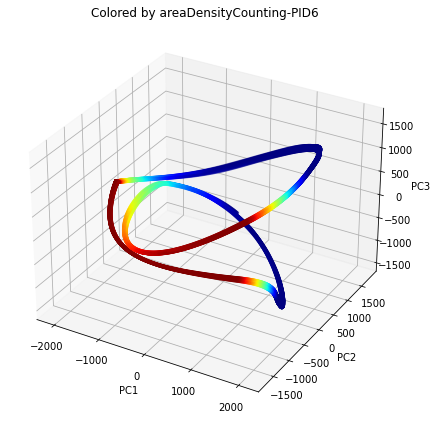

<Figure size 432x288 with 0 Axes>

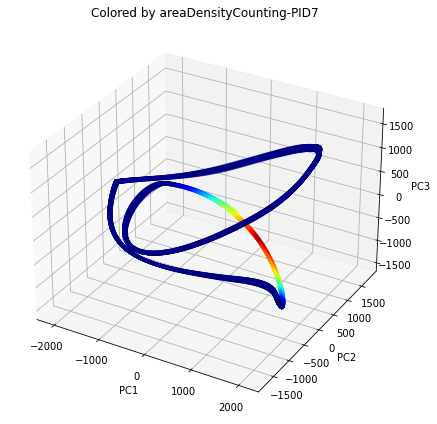

<Figure size 432x288 with 0 Axes>

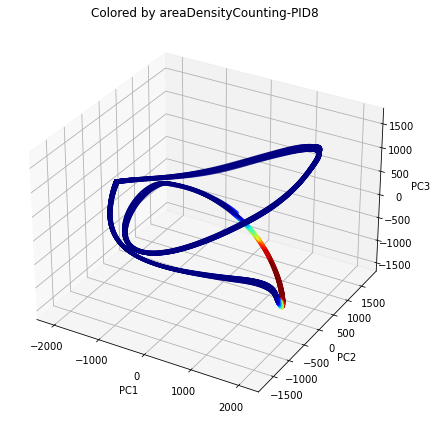

<Figure size 432x288 with 0 Axes>

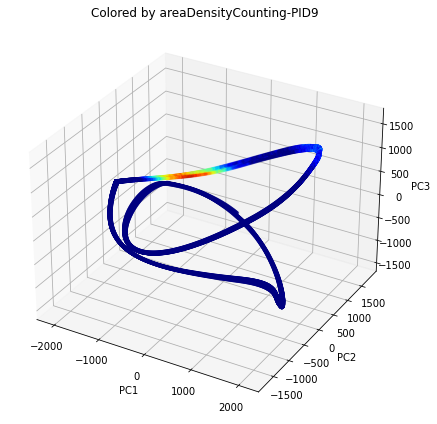

<Figure size 432x288 with 0 Axes>

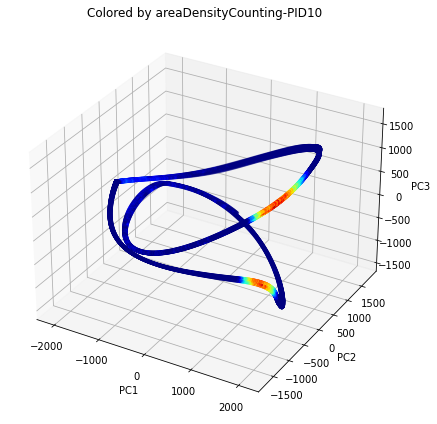

<Figure size 432x288 with 0 Axes>

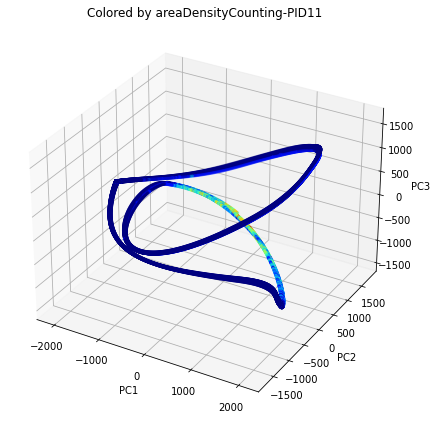

<Figure size 432x288 with 0 Axes>

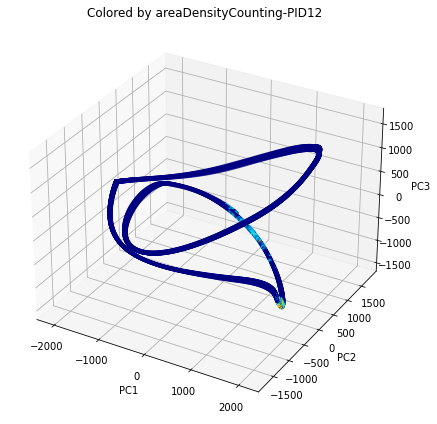

<Figure size 432x288 with 0 Axes>

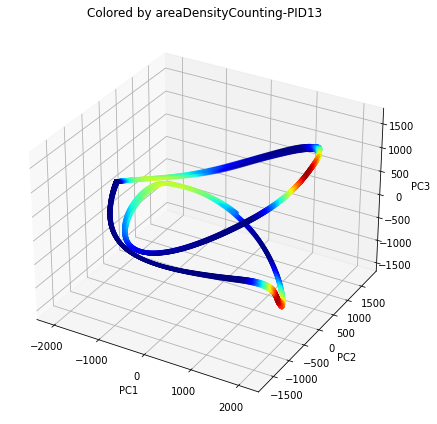

In [9]:
for i in range(1, 10):
    plt.tight_layout()
    fig = plt.figure(figsize=(10, 6))
    ax = plt.axes(projection='3d')
    ax.scatter(
        pca_data[:, 0],
        pca_data[:, 1],
        pca_data[:, 2],
        c=data[:len(data)-WINDOW_LENGTH, i],
        cmap='jet',
        marker='.'
    )
    ax.set_title('Colored by areaDensityCounting-PID{}'.format(i+4))
    ax.set_xlabel('PC1')
    ax.set_ylabel('PC2')
    ax.set_zlabel('PC3')
    fig.savefig('figures/task_5_{}.png'.format(i))
    plt.show()

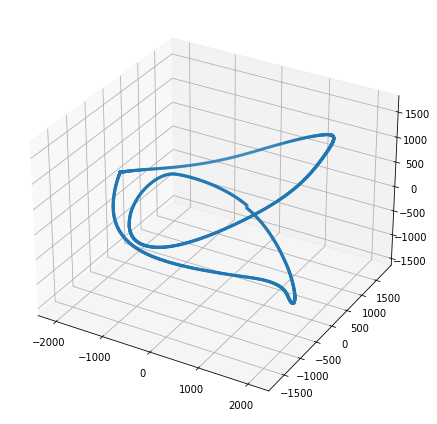

In [10]:
fig = plt.figure(figsize=(10, 6))
ax = plt.axes(projection='3d')
ax.scatter(
    pca_data[:1992, 0],
    pca_data[:1992, 1],
    pca_data[:1992, 2],
    marker='.'
)
plt.show()

In [11]:
LOOP_LENGTH = 1992
arc_velocities = []
for i in range(0, len(pca_data)-1):
    arc_velocities.append(np.linalg.norm(pca_data[i+1] - pca_data[i]))
arc_length_accumulated = np.cumsum(arc_velocities)

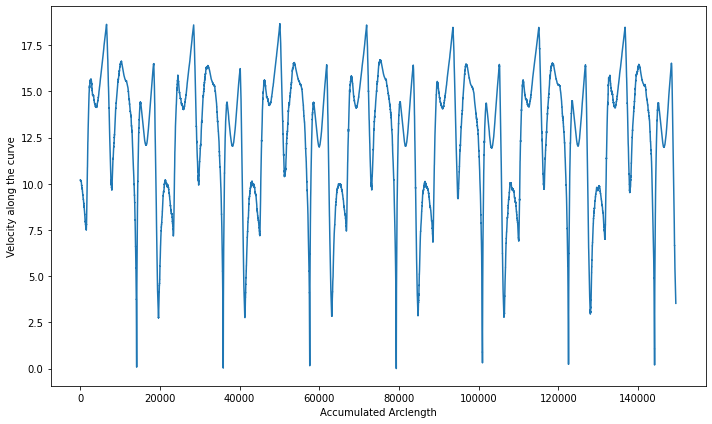

In [12]:
fig = plt.figure(figsize=(10, 6))
plt.plot(arc_length_accumulated, arc_velocities)
plt.xlabel('Accumulated Arclength')
plt.ylabel('Velocity along the curve')
plt.show()

In [13]:
delta_time = 1
rbf_arcvelocity = RBF(arc_length_accumulated[:LOOP_LENGTH-1],arc_length_accumulated[1:LOOP_LENGTH], 300, 200, delta_time)
arcvelocity_interpolated = rbf_arcvelocity.rbf(arc_length_accumulated[:LOOP_LENGTH-1].reshape(-1, 1))

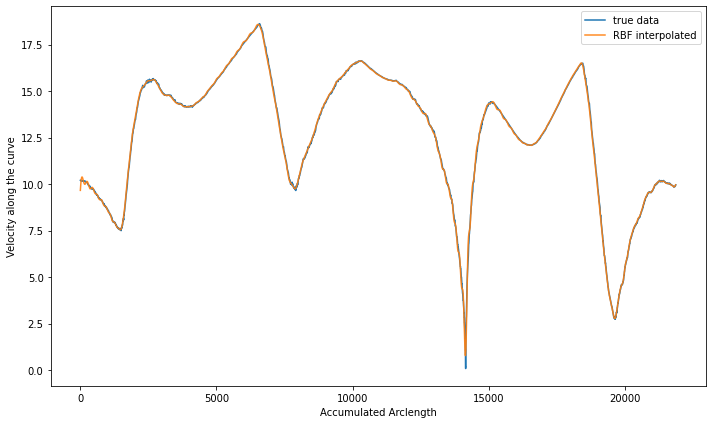

In [32]:
# One loop
fig = plt.figure(figsize=(10, 6))
plt.plot(arc_length_accumulated[:LOOP_LENGTH], arc_velocities[:LOOP_LENGTH], label='true data')
plt.plot(arc_length_accumulated[:LOOP_LENGTH-1], arcvelocity_interpolated, alpha=0.9, label='RBF interpolated')
plt.xlabel('Accumulated Arclength')
plt.ylabel('Velocity along the curve')
plt.legend()
plt.show()

In [15]:
rbf_arclength_2_mi_density = RBF(arc_length_accumulated[:LOOP_LENGTH], data[:LOOP_LENGTH, 1], 10, 2000, delta_time, vector_field=False)
mi_density_interpolated = rbf_arclength_2_mi_density.rbf(arc_length_accumulated[:LOOP_LENGTH].reshape(-1, 1))

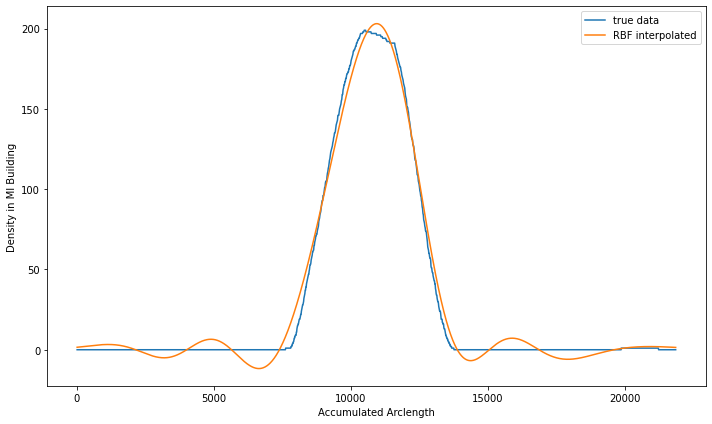

In [16]:
# One loop
fig = plt.figure(figsize=(10, 6))
plt.plot(arc_length_accumulated[:LOOP_LENGTH], data[:LOOP_LENGTH, 1], label='true data')
plt.plot(arc_length_accumulated[:LOOP_LENGTH], mi_density_interpolated, label='RBF interpolated')
plt.xlabel('Accumulated Arclength')
plt.ylabel('Density in MI Building')
plt.legend()
plt.show()

In [18]:
rbf_arcvelocity.rbf(np.array([0]).reshape(-1, 1))

array([9.38405625])

In [21]:
mi_density_interpolated = []
for day in range(1, 15):
    arclength = 0
    point_arclengths = []
    while len(point_arclengths) < LOOP_LENGTH:
        point_arclengths.append(arclength)
        velocity = rbf_arcvelocity.rbf(np.array([arclength]).reshape(-1, 1))[0]
        arclength += velocity
    mi_density_interpolated_day = rbf_arclength_2_mi_density.rbf(np.array(point_arclengths).reshape(-1, 1))
    mi_density_interpolated.append(mi_density_interpolated_day)

In [25]:
mi_density_interpolated = np.concatenate(mi_density_interpolated, axis=None)

In [26]:
mi_density_interpolated.shape

(27888,)

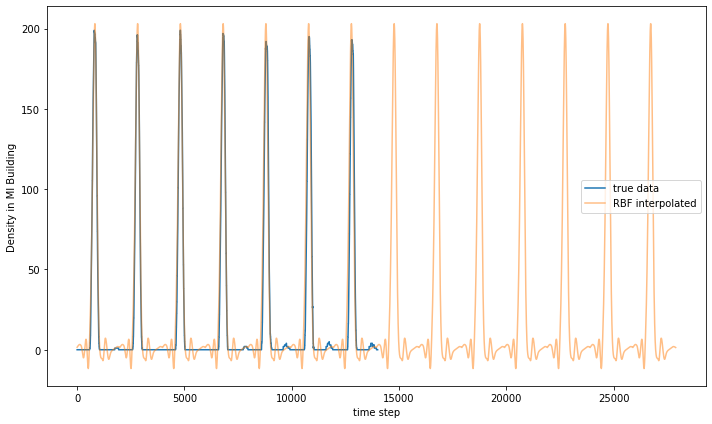

In [29]:
# One loop
fig = plt.figure(figsize=(10, 6))
plt.plot(data[:, 1], label='true data')
plt.plot(mi_density_interpolated, alpha=0.5, label='RBF interpolated')
plt.xlabel('time step')
plt.ylabel('Density in MI Building')
plt.legend()
plt.show()